In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

## Correlation Plot

Performing Correlation to check feature dependency:

Insights from Heatmap

Strong Positive Correlations:
1. Price and PE ratio have a positive correlation (0.20), indicating that higher prices are associated with higher PE ratios.
2. Revenue and Free cash flow are positively correlated (0.48), which makes sense as higher revenue often leads to higher free cash flow.

Negative Correlations:
1. Free cash flow and Total debt have a negative correlation (-0.56), suggesting that companies with higher free cash flow tend to have lower debt.

Weak Correlations:
1. ROE and PE ratio have a very weak correlation (-0.05), indicating little to no relationship between these features and they are independent.



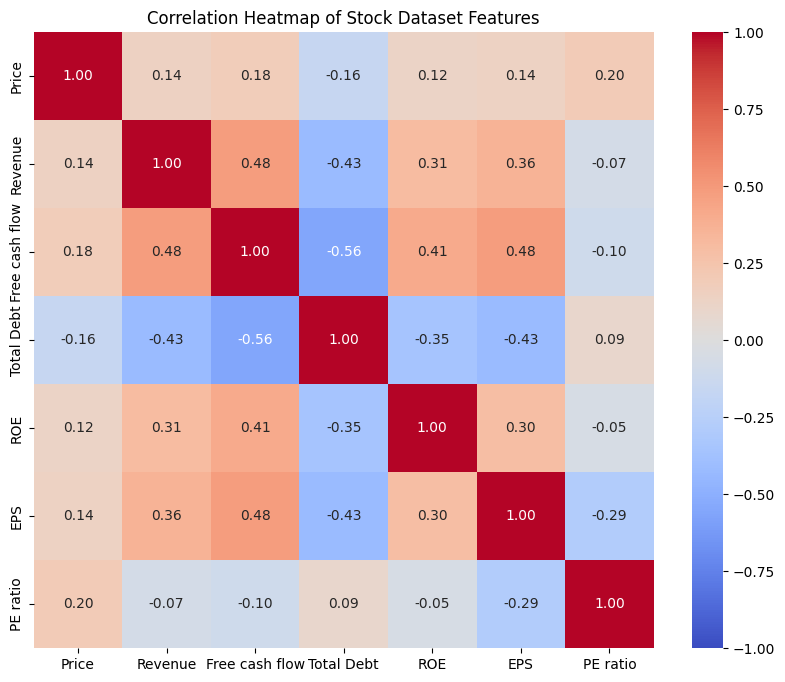

In [12]:
data = pd.read_csv("dataset_preprocessed.csv", usecols=["Date", "Company", "Price", "Revenue", "Free cash flow", "Total Debt", "ROE", "EPS", "PE ratio", "Target"])

# Select numerical features for correlation analysis
numerical_features = ['Price', 'Revenue', 'Free cash flow', 'Total Debt', 'ROE', 'EPS', 'PE ratio']
data_numerical = data[numerical_features]

# Compute the correlation matrix
correlation_matrix = data_numerical.corr()

# Create a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", vmin=-1, vmax=1)
plt.title("Correlation Heatmap of Stock Dataset Features")
plt.show()

## Different Feature analysis Plots

Generating different plots to analyse the data
1. scatter plot between features
2. Plot all features of all companies togther, this is not much useful but helps in understanding global outliers in the data.
3. Plotting each feature individually for all companies across the time duration
4. Scatter plot the above.

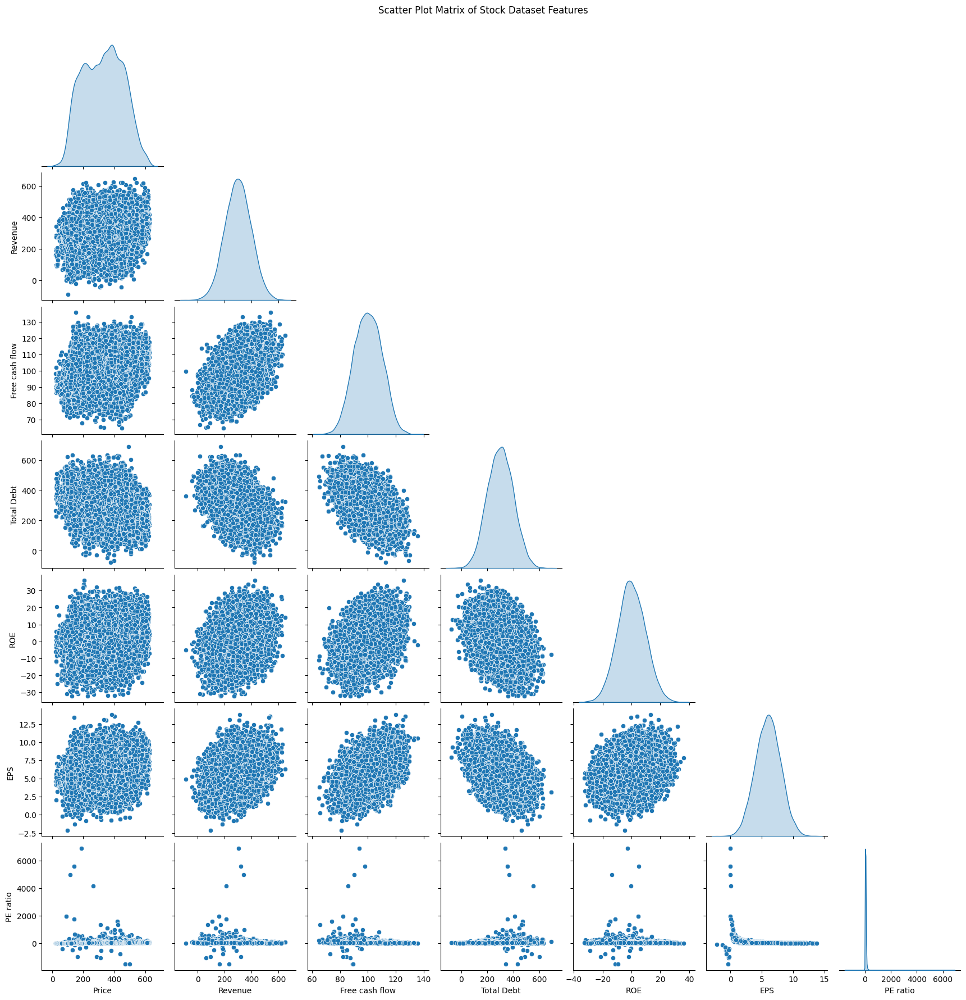

In [2]:
data = pd.read_csv("dataset_preprocessed.csv", usecols=["Date", "Company", "Price", "Revenue", "Free cash flow", "Total Debt", "ROE", "EPS", "PE ratio", "Target"])

# Select numerical features for visualization
numerical_features = ['Price', 'Revenue', 'Free cash flow', 'Total Debt', 'ROE', 'EPS', 'PE ratio']
data_numerical = data[numerical_features]

# Generate scatter plot matrix
sns.pairplot(data_numerical, diag_kind='kde', corner=True)
plt.suptitle("Scatter Plot Matrix of Stock Dataset Features", y=1.02)
plt.show()

<ipython-input-3-1c94d7506c62>:30: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


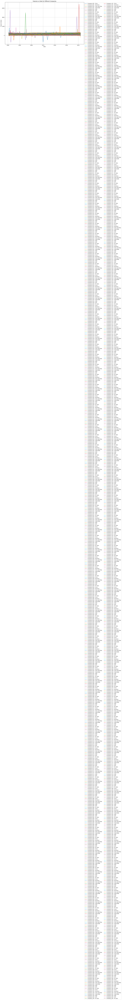

In [3]:
import pandas as pd
import matplotlib.pyplot as plt

data = pd.read_csv("dataset_preprocessed.csv", usecols=["Date", "Company", "Price", "Revenue", "Free cash flow", "Total Debt", "ROE", "EPS", "PE ratio", "Target"])

# Convert the 'Date' column to datetime format
data['Date'] = pd.to_datetime(data['Date'])

# Define the features to plot
features = ['Price', 'Revenue', 'Free cash flow', 'Total Debt', 'ROE', 'EPS', 'PE ratio']


plt.figure(figsize=(15, 8))
for company in data['Company'].unique():
    company_data = data[data['Company'] == company]
    for feature in features:
        plt.plot(company_data['Date'], company_data[feature], label=f"{company} - {feature}")

plt.xlabel("Date")
plt.ylabel("Feature Values")
plt.title("Features vs Date for Different Companies")
plt.legend(loc="upper left", bbox_to_anchor=(1, 1), ncol=2)  # Adjust legend position
plt.grid(True)

plt.tight_layout()
plt.show()

<ipython-input-7-546118f492a1>:31: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


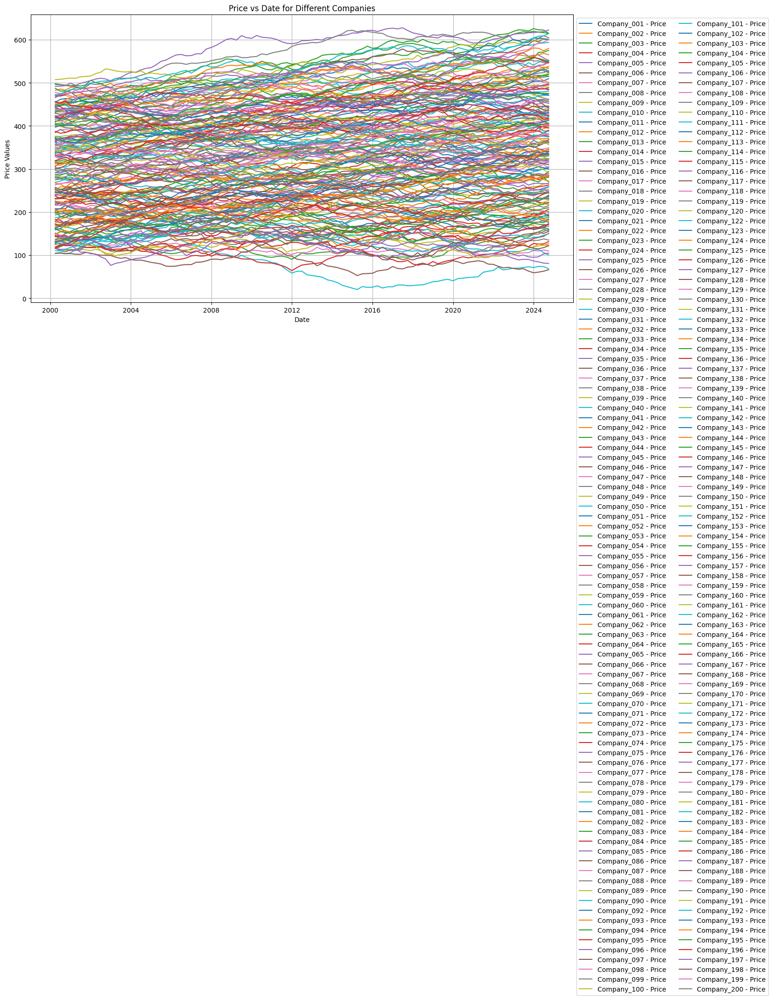

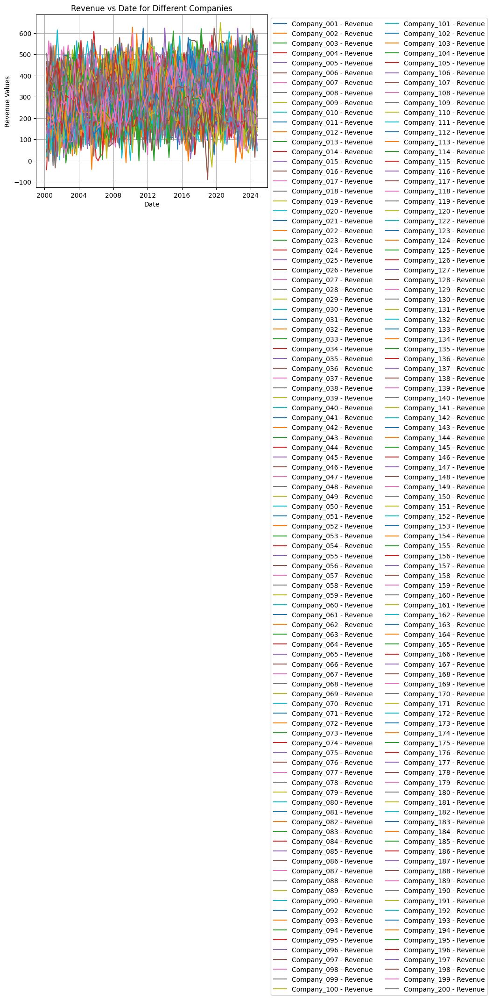

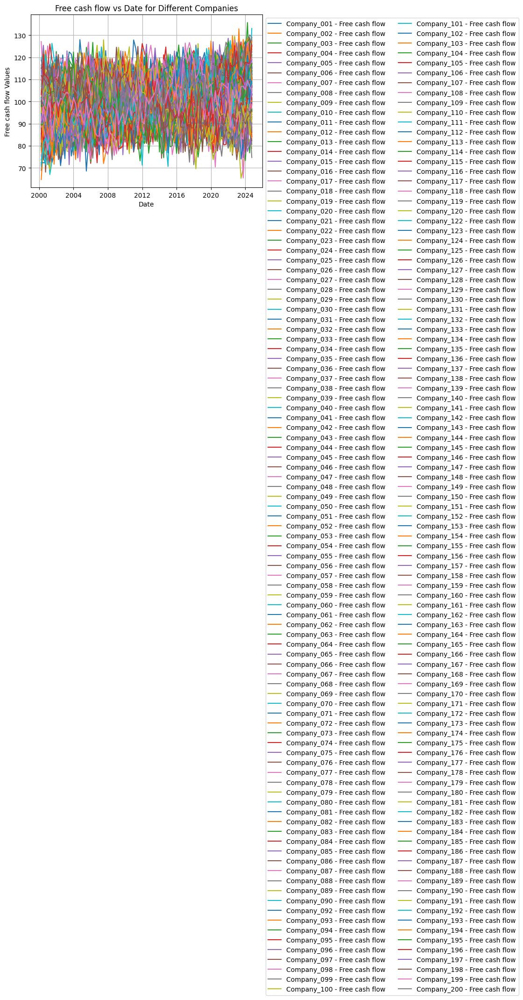

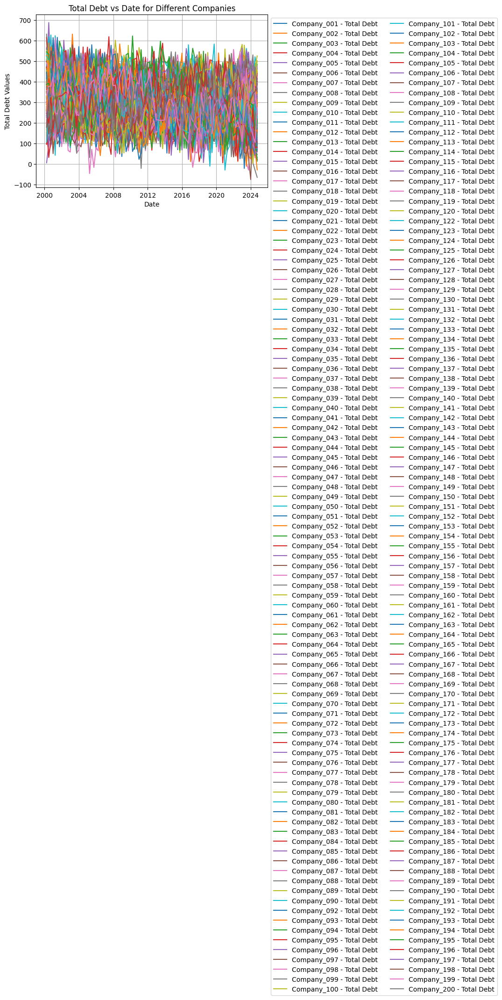

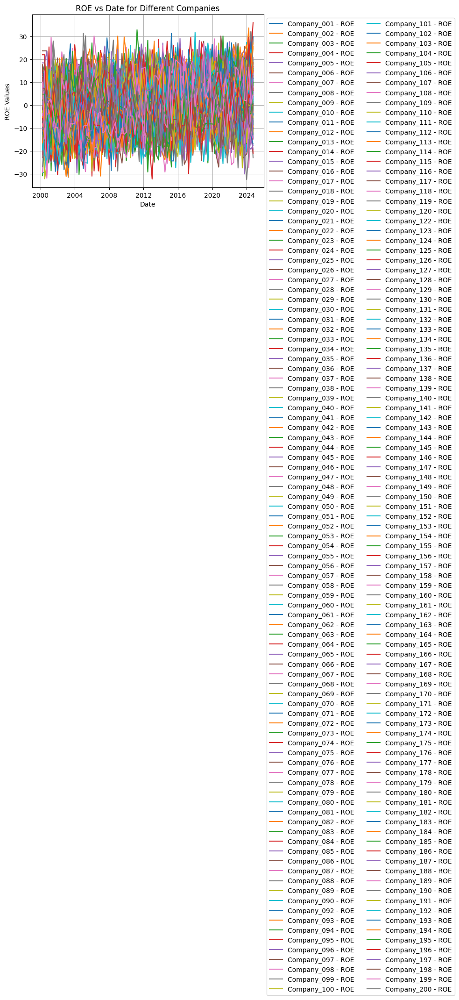

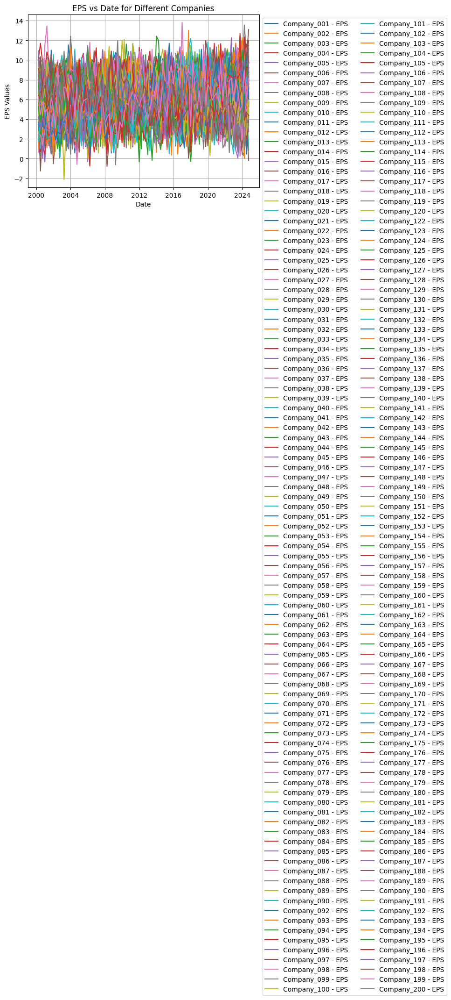

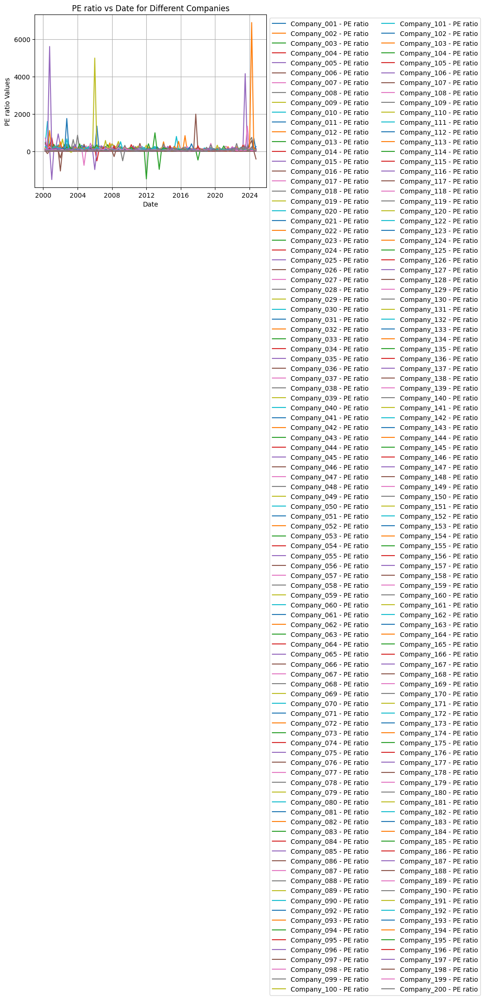

In [7]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the stock dataset
data = pd.read_csv("dataset_preprocessed.csv", usecols=["Date", "Company", "Price", "Revenue", "Free cash flow", "Total Debt", "ROE", "EPS", "PE ratio", "Target"])

# Convert the 'Date' column to datetime format
data['Date'] = pd.to_datetime(data['Date'])

# Define the features to plot
features = ['Price', 'Revenue', 'Free cash flow', 'Total Debt', 'ROE', 'EPS', 'PE ratio']

# Create a plot
plt.figure(figsize=(15, 8))

# Loop through each company and plot all features

for feature in features:
  for company in data['Company'].unique():
    company_data = data[data['Company'] == company]
    plt.plot(company_data['Date'], company_data[feature], label=f"{company} - {feature}")

  # Add labels, legend, and title
  plt.xlabel("Date")
  plt.ylabel(f"{feature} Values")
  plt.title(f"{feature} vs Date for Different Companies")
  plt.legend(loc="upper left", bbox_to_anchor=(1, 1), ncol=2)  # Adjust legend position
  plt.grid(True)

  # Show the plot
  plt.tight_layout()
  plt.show()

<Figure size 1500x800 with 0 Axes>

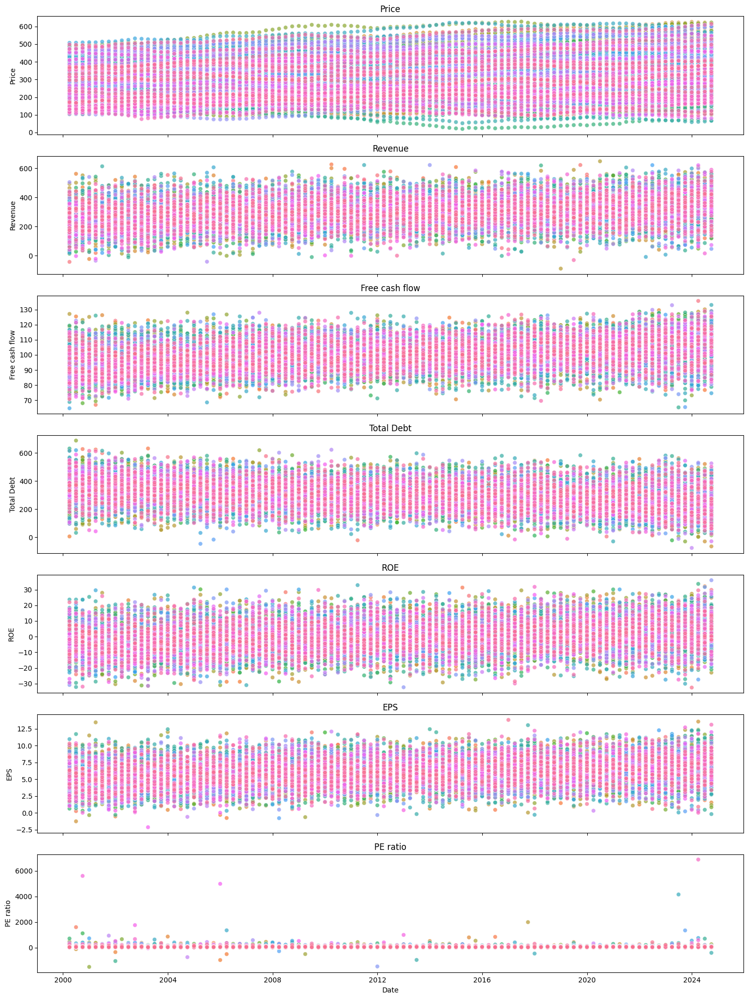

In [8]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the stock dataset
data = pd.read_csv("dataset_preprocessed.csv", usecols=["Date", "Company", "Price", "Revenue", "Free cash flow", "Total Debt", "ROE", "EPS", "PE ratio", "Target"])

# Convert the 'Date' column to datetime format
data['Date'] = pd.to_datetime(data['Date'])

# Define the features to plot
features = ['Price', 'Revenue', 'Free cash flow', 'Total Debt', 'ROE', 'EPS', 'PE ratio']

# Create a plot
plt.figure(figsize=(15, 8))

# Loop through each company and plot all features

fig, axes = plt.subplots(len(features), 1, figsize=(15, 20), sharex=True)
for i, feature in enumerate(features):
    sns.scatterplot(data=data, x='Date', y=feature, hue='Company', ax=axes[i], alpha=0.7, legend=False)
    axes[i].set_title(feature)
plt.tight_layout()
plt.show()

## Check Stationarity
using Augmented Dickey Fuller(ADF) Test

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller

In [15]:
# Load the stock dataset
data = pd.read_csv("dataset_preprocessed.csv", usecols=["Date", "Company", "Price", "Revenue", "Free cash flow", "Total Debt", "ROE", "EPS", "PE ratio", "Target"])

data['Date'] = pd.to_datetime(data['Date'])

# Sort the data by Date
data = data.sort_values(['Company', 'Date'])

# Display the first few rows
print(data.head())


        Date      Company     Price   Revenue  Free cash flow  Total Debt  \
0 2000-03-31  Company_001  245.3685  345.8772         95.9499    278.9544   
1 2000-06-30  Company_001  244.0929  345.8772         95.1830    268.4601   
2 2000-09-30  Company_001  245.2091  362.1441         96.1191    381.6432   
3 2000-12-31  Company_001  241.1670  248.8992        103.6387    385.7371   
4 2001-03-31  Company_001  238.8435  199.8377        106.3144    417.9813   

       ROE       EPS  PE ratio  Target  
0  -1.2080  8.491500   28.7456       0  
1  -0.6373  5.406400   45.3553       1  
2   1.6280  4.861800   49.6044       0  
3   1.7514  8.143572   29.6144       0  
4  11.8964  3.737300   63.3460       0  


In [19]:
def plot_graph_for_feature(data, feature):
  for company in data['Company'].unique():
    company_data = data[data['Company'] == company]
    plt.plot(company_data['Date'], company_data[feature], label=f"{company} - {feature}")

  # Add labels, legend, and title
  plt.xlabel("Date")
  plt.ylabel(f"{feature} Values")
  plt.title(f"{feature} vs Date for Different Companies")
  plt.legend(loc="upper left", bbox_to_anchor=(1, 1), ncol=2)  # Adjust legend position
  plt.grid(True)

  # Show the plot
  plt.tight_layout()
  plt.show()

In [20]:
def adf_test(data, feature):
  # Perform ADF test on the feature column
  result = adfuller(data[feature].dropna())  # Drop NA values if any

  # Extract test results
  print("ADF Test Results:")
  print(f"Test Statistic: {result[0]}")
  print(f"P-Value: {result[1]}")
  print(f"Critical Values: {result[4]}")

  # Check stationarity
  if result[1] <= 0.05:
      print("The time series is stationary (reject null hypothesis).")
  else:
      print("The time series is non-stationary (fail to reject null hypothesis).")

<ipython-input-19-62ee4a9ea154>:14: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


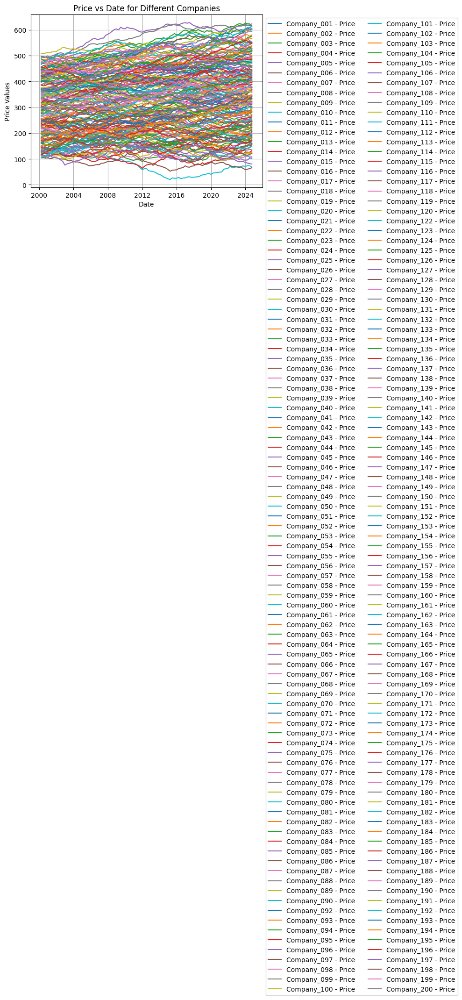

ADF Test Results:
Test Statistic: -10.91186119921438
P-Value: 1.0918389381150134e-19
Critical Values: {'1%': np.float64(-3.43068369848865), '5%': np.float64(-2.861687482837679), '10%': np.float64(-2.566848501113508)}
The time series is stationary (reject null hypothesis).


In [21]:
feature = 'Price'
plot_graph_for_feature(data, feature)
adf_test(data, feature)



<ipython-input-19-62ee4a9ea154>:14: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


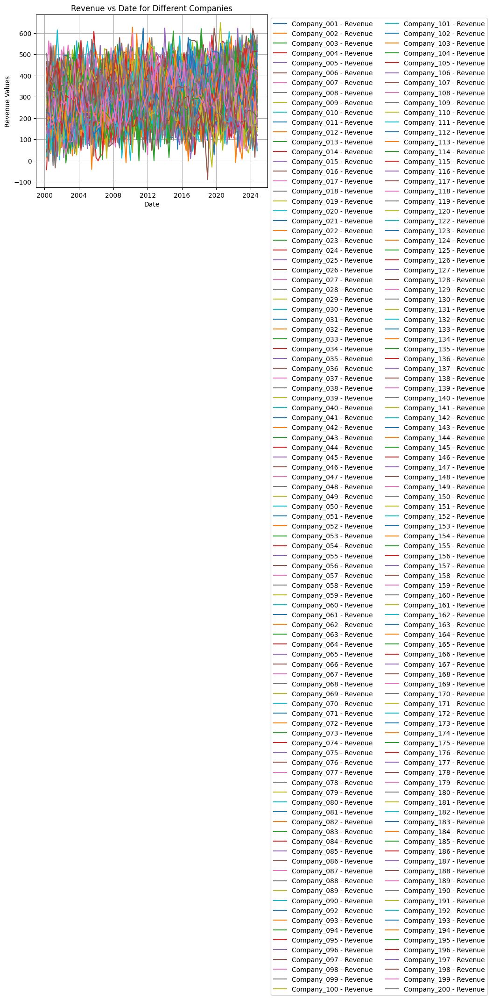

ADF Test Results:
Test Statistic: -23.160730599048726
P-Value: 0.0
Critical Values: {'1%': np.float64(-3.430684415223157), '5%': np.float64(-2.8616877995909427), '10%': np.float64(-2.5668486697157764)}
The time series is stationary (reject null hypothesis).


In [22]:
feature = 'Revenue'
plot_graph_for_feature(data, feature)
adf_test(data, feature)

<ipython-input-19-62ee4a9ea154>:14: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


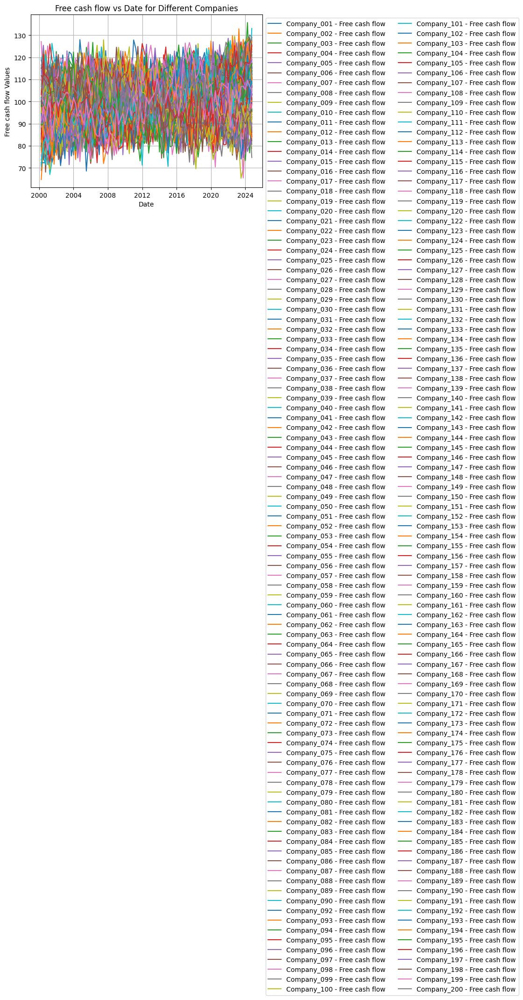

ADF Test Results:
Test Statistic: -23.245809888452804
P-Value: 0.0
Critical Values: {'1%': np.float64(-3.430684432325792), '5%': np.float64(-2.861687807149271), '10%': np.float64(-2.5668486737389435)}
The time series is stationary (reject null hypothesis).


In [23]:
feature = 'Free cash flow'
plot_graph_for_feature(data, feature)
adf_test(data, feature)

<ipython-input-19-62ee4a9ea154>:14: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


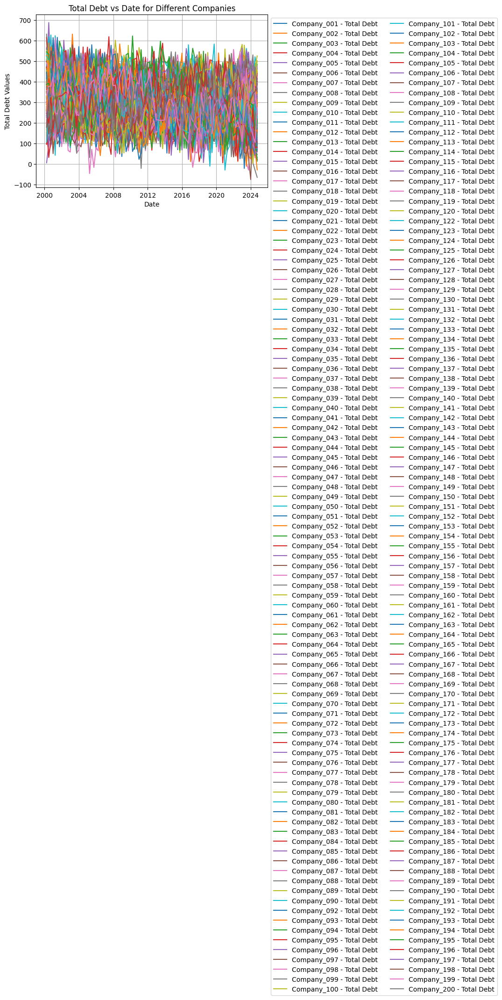

ADF Test Results:
Test Statistic: -23.372217234400814
P-Value: 0.0
Critical Values: {'1%': np.float64(-3.430684432325792), '5%': np.float64(-2.861687807149271), '10%': np.float64(-2.5668486737389435)}
The time series is stationary (reject null hypothesis).


In [24]:
feature = 'Total Debt'
plot_graph_for_feature(data, feature)
adf_test(data, feature)

<ipython-input-19-62ee4a9ea154>:14: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


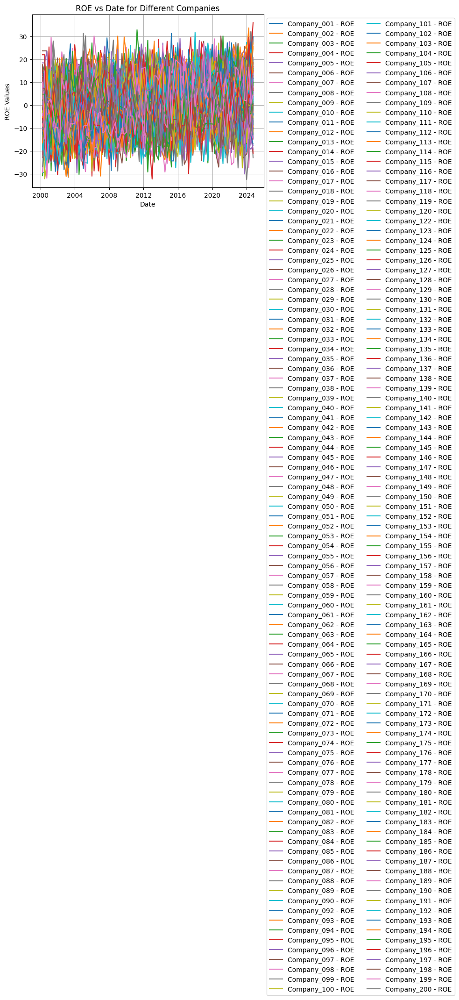

ADF Test Results:
Test Statistic: -23.79850710840794
P-Value: 0.0
Critical Values: {'1%': np.float64(-3.430684415223157), '5%': np.float64(-2.8616877995909427), '10%': np.float64(-2.5668486697157764)}
The time series is stationary (reject null hypothesis).


In [25]:
feature = 'ROE'
plot_graph_for_feature(data, feature)
adf_test(data, feature)

<ipython-input-19-62ee4a9ea154>:14: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


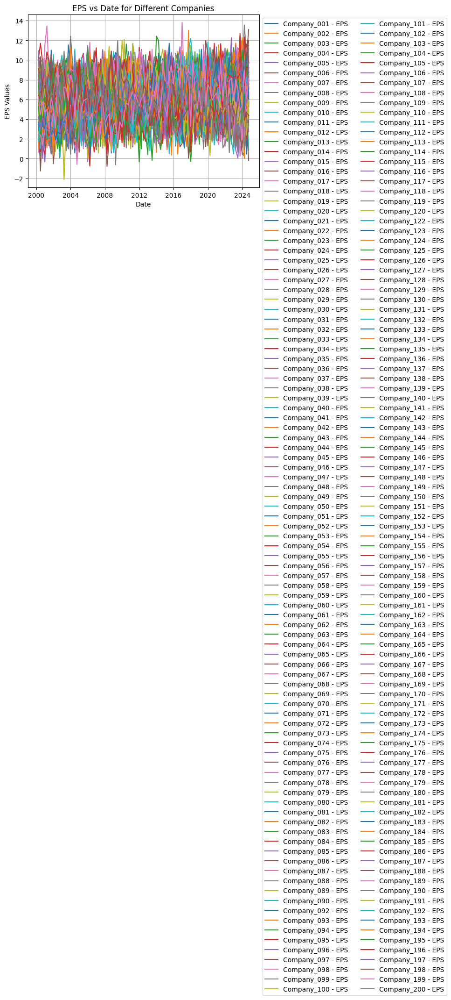

ADF Test Results:
Test Statistic: -23.86080023209228
P-Value: 0.0
Critical Values: {'1%': np.float64(-3.430684432325792), '5%': np.float64(-2.861687807149271), '10%': np.float64(-2.5668486737389435)}
The time series is stationary (reject null hypothesis).


In [26]:
feature = 'EPS'
plot_graph_for_feature(data, feature)
adf_test(data, feature)

<ipython-input-19-62ee4a9ea154>:14: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


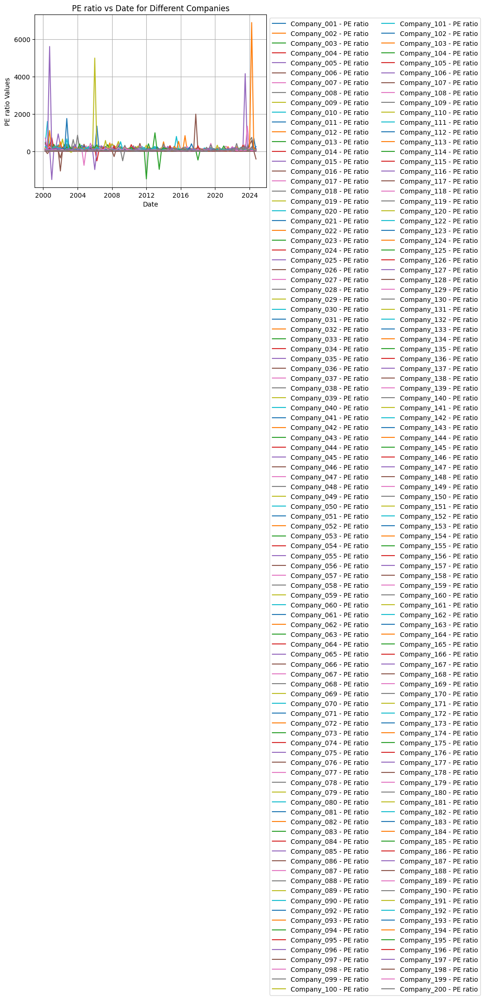

ADF Test Results:
Test Statistic: -18.95605422721487
P-Value: 0.0
Critical Values: {'1%': np.float64(-3.430684107674567), '5%': np.float64(-2.861687663673093), '10%': np.float64(-2.5668485973690607)}
The time series is stationary (reject null hypothesis).


In [28]:
feature = 'PE ratio'
plot_graph_for_feature(data, feature)
adf_test(data, feature)